In [1]:
# imports

import numpy as np
import matplotlib.pyplot as plt

In [44]:
# define the system

nt = 10000 # number of time steps
dt = 0.00001 # initial time step
rel = 0.1 # time relaxation factor (1-alpha)
nu = 0.1 # kinematic viscosity
lidv = 120.0 # lid velocity

n = 20 # number of nodes per row (or column)

# physical dimensions
x = np.linspace(0,1.0,n)
y = np.linspace(0,1.0,n)
dx = x[1] - x[0]
dy = y[1] - y[0]

# flow variables
U_init = np.zeros((n,n-1))
U_init[-1,:] = lidv
V_init = np.zeros((n-1,n))
stream_init = np.zeros((n,n))
vort_init = np.zeros((n,n))

In [45]:
# define solver functions

def A(W,U,V,i,j):
    """
    Advective term
    
    W = vorticity
    U = u vel
    v = v vel
    """
    
    return (0.5*(U[i,j]+U[i,j-1]))*(0.5*(W[i,j+1]+W[i,j]) - 0.5*(W[i,j]+W[i,j-1]))/dx + (0.5*(V[i,j]+V[i-1,j]))*(0.5*(W[i+1,j]+W[i,j]) - 0.5*(W[i,j]+W[i-1,j]))/dy

def B(W,i,j):
    """
    Viscous term

    W = vorticity
    U = u vel
    V = v vel
    """
    return (W[i+1,j]-2*W[i,j]+W[i-1,j])/(dy**2) + (W[i,j+1]-2*W[i,j]+W[i,j-1])/(dx**2)

def recover_stream(W,S):
    """
    Recover the stream values for time step n+1

    W = vorticity
    """
    S_new = S*0 + S
    for i in range(1,n-1):
        for j in range(1,n-1):
            S_new[i,j] = 0.25*(S[i+1,j]+S[i-1,j]+S[i,j+1]+S[i,j-1]+(dx**2)*W[i,j])
    S_new[0,:] = 0
    S_new[-1,:] = 0
    S_new[:,0] = 0
    S_new[:,-1] = 0
    
    return S_new

def recover_velocity(S,U,V):
    """
    Recover the velocity field for time step n+1

    S = stream function
    """

    U_new = U*0 + U
    V_new = V*0 + V

    for i in range(1,len(U[:,0])-1):
        for j in range(1,len(U[0,:])-1):
            U_new[i,j] = 0.5*((0.5*(S[i,j+1]+S[i,j])/dy - 0.5*(S[i-1,j+1]+S[i-1,j])/dy) + (0.5*(S[i+1,j]+S[i+1,j+1])/dy - 0.5*(S[i,j]+S[i,j+1])/dy))

    for i in range(1,len(V[:,0])-1):
        for j in range(1,len(V[0,:])-1):
            V_new[i,j] = -0.5*((0.5*(S[i,j]+S[i+1,j])/dx - 0.5*(S[i,j-1]+S[i+1,j-1])/dx) + (0.5*(S[i,j+1]+S[i+1,j+1])/dx - 0.5*(S[i,j]+S[i+1,j])/dx))

    return U_new, V_new


In [46]:
# solver: AB2 advective






# flow variables
U_old = U_init*0 + U_init
V_old = V_init*0 + V_init
S_old = stream_init*0 + stream_init
W_old = vort_init*0 + vort_init

U = U_old*0 + U_old
V = V_old*0 + V_old
S = S_old*0 + S_old
W = W_old*0 + W_old



# store intermediate time step solutions
solutions = []

# jet params
lower_index = int(np.floor(n/2)-2)
upper_index = int(np.ceil(n/2)+2)
protrusion_index = int(np.ceil(1.0/dx))

# initial time step: FTCS
        
# interior field
for i in range(1,n-1):
    for j in range(1,n-1):
        W[i,j] = W[i,j] - dt*A(W,U,V,i,j) + nu*dt*B(W,i,j)

# recover stream function
S_tmp = S_old*0 + S_old
S = recover_stream(W,S_tmp)
while np.linalg.norm(S-S_tmp) > 1e8:
    S_tmp = S*0 + S
    S = recover_stream(W,S_tmp)
        
# boundary
W[-1,:] = -2*(S[-2,:]/(dy**2)) - 2*(lidv/dy) # top
W[0,:] = -2*(S[1,:]/(dy**2)) # bottom
W[:,-1] = -2*(S[:,-2]/(dx**2)) # right
W[:,0] = -2*(S[:,1]/(dx**2)) # left

# recover velocity
U, V = recover_velocity(S,U,V)



# time marching
for t in range(nt):
    # store temporary flow variables
    U_tmp = U*0 + U
    V_tmp = V*0 + V
    S_tmp = S*0 + S
    W_tmp = W*0 + W

    # Time step variable with characteristic velocity
    dt = rel*dx/(4*np.max(np.abs(U)) + 4*np.max(np.abs(V)))
    
    # interior field
    for i in range(1,n-1):
        for j in range(1,n-1):
            W[i,j] = W[i,j] - 1.5*dt*A(W,U,V,i,j) + 0.5*dt*A(W_old,U_old,V_old,i,j) + nu*dt*B(W,i,j)

    # recover stream function
    S_tmp = S*0 + S
    S = recover_stream(W,S_tmp)
    while np.linalg.norm(S-S_tmp) > 1e8:
        S_tmp = S*0 + S
        S = recover_stream(W,S_tmp)

    # boundary
    W[-1,:] = -2*(S[-2,:]/(dy**2)) - 2*(lidv/dy) # top
    W[0,:] = -2*(S[1,:]/(dy**2)) # bottom
    W[:,-1] = -2*(S[:,-2]/(dx**2)) # right
    W[:,0] = -2*(S[:,1]/(dx**2)) # left

    # recover velocity
    U, V = recover_velocity(S,U,V)

    # prior time step flow variables
    U_old = U_tmp*0 + U_tmp
    V_old = V_tmp*0 + V_tmp
    S_old = S_tmp*0 + S_tmp
    W_old = W_tmp*0 + W_tmp

    if t % 10 == 0:
        solutions.append(np.hypot(0.5*(U[:-1,:] + U[1:,:]), 0.5*(V[:,:-1] + V[:,1:])))

Animation size has reached 21002916 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


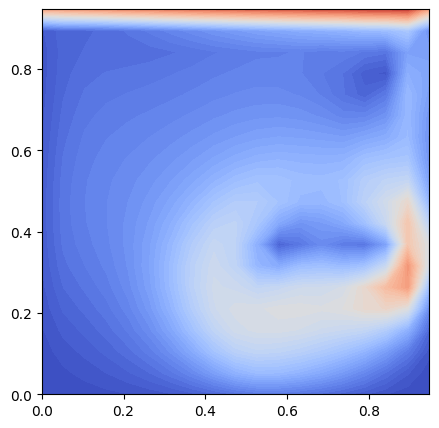

In [47]:
from matplotlib.animation import FuncAnimation


# plotting params
fig,ax = plt.subplots(figsize=(5,5))
X,Y = np.meshgrid(x[:-1],y[:-1])
frames = np.arange(0,len(solutions))
vmin, vmax = np.min(solutions), np.max(solutions)

def func(i):
    ax.clear()
    ax.contourf(X,Y,solutions[i],levels=70,cmap="coolwarm",vmin=vmin,vmax=vmax)

_animation = FuncAnimation(fig,func=func,frames=frames)

from IPython.display import HTML
HTML(_animation.to_jshtml())

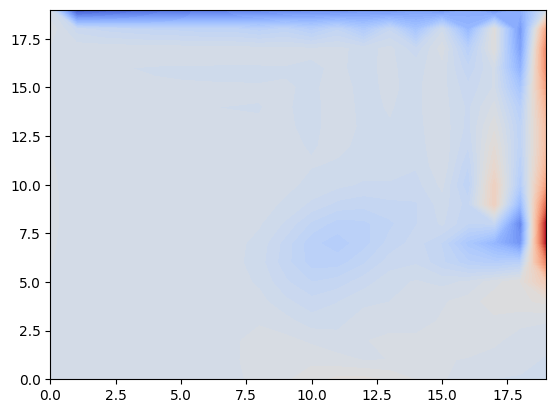

In [49]:
plt.contourf(W,cmap="coolwarm",levels=70)